In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
image_path = "/content/trichome2.jpeg"

### Detect sigmas and count

In [ ]:

def detect_stigmas_bounding_box(image_path):
    image = cv2.imread(image_path)
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    lower_orange = np.array([5, 100, 100])
    upper_orange = np.array([20, 255, 255])

    mask = cv2.inRange(hsv_image, lower_orange, upper_orange)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Draw bounding boxes around detected stigmas and count them
    stigma_count = 0
    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
        cv2.rectangle(image, (x, y), (x+w, y+h), (0, 255, 0), 2)
        stigma_count += 1

    # Convert image from BGR to RGB for display using matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Plot the image with annotations and display the count
    plt.imshow(image_rgb)
    plt.title(f'Detected Stigmas: {stigma_count}')
    plt.axis('off')
    plt.show()


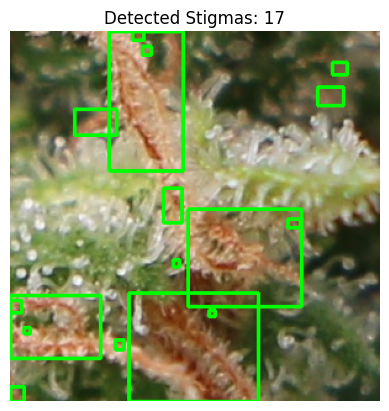

In [ ]:
# Call the function with the path to your image
detect_stigmas_bounding_box(image_path)

### Segment Stigmas

In [ ]:
def segment_stigmas_no_background(image_path):
    image = cv2.imread(image_path)
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    lower_orange = np.array([5, 100, 100])
    upper_orange = np.array([20, 255, 255])

    mask = cv2.inRange(hsv_image, lower_orange, upper_orange)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

    # Segment the stigmas by applying the mask to the original image
    segmented_image = cv2.bitwise_and(image, image, mask=mask)

    # Convert image from BGR to RGB for display using matplotlib
    segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)

    # Plot the segmented image
    plt.imshow(segmented_image_rgb)
    plt.title('Segmented Stigmas')
    plt.axis('off')
    plt.show()



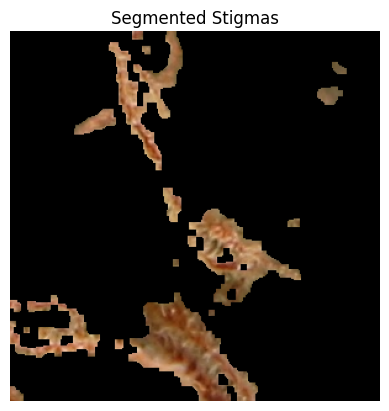

In [ ]:
# Call the function with the path to your image
segment_stigmas_no_background(image_path)

### return a list of coordinated of the stigmas

we will do this to search for trichomes in areas where there are stigmas

In [ ]:
def get_stigma_coordinates(image_path):
    image = cv2.imread(image_path)
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    lower_orange = np.array([5, 100, 100])
    upper_orange = np.array([20, 255, 255])

    mask = cv2.inRange(hsv_image, lower_orange, upper_orange)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Create a list to store the coordinates of the detected stigmas
    stigma_coordinates = []

    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)
        # Store the coordinates as tuples (x, y, width, height)
        stigma_coordinates.append((x, y, w, h))

    return stigma_coordinates

In [ ]:
# Call the function with the path to your image
stigma_coordinates = get_stigma_coordinates(image_path)

# Print the list of coordinates
print(stigma_coordinates)
print(len(stigma_coordinates))

[(0, 288, 11, 12), (85, 250, 7, 8), (11, 240, 5, 5), (161, 226, 5, 5), (0, 218, 9, 10), (0, 214, 73, 51), (96, 212, 105, 88), (132, 185, 5, 6), (225, 152, 10, 7), (144, 144, 92, 79), (124, 127, 15, 28), (52, 63, 34, 21), (249, 45, 21, 15), (261, 25, 12, 10), (107, 12, 7, 7), (80, 0, 60, 113), (99, 0, 9, 7)]
17


### Segment stigmas with background

In [ ]:
def segment_stigmas(image):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    lower_orange = np.array([5, 100, 100])
    upper_orange = np.array([20, 255, 255])

    mask = cv2.inRange(hsv_image, lower_orange, upper_orange)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

    # Segment the stigmas by applying the mask to the original image
    segmented_image = cv2.bitwise_and(image, image, mask=mask)

    # Overlay the segmented stigmas on the original image
    # Using a weight of 0.7 for the original image and 0.3 for the segmented_image
    alpha = 0.9
    beta = 0.5
    overlay_image = cv2.addWeighted(image, alpha, segmented_image, beta, 0)

    # Convert image from BGR to RGB for display using matplotlib
    overlay_image_rgb = cv2.cvtColor(overlay_image, cv2.COLOR_BGR2RGB)

    # Plot the overlay image
    plt.imshow(overlay_image_rgb)
    plt.title('Segmented Stigmas Overlay')
    plt.axis('off')
    plt.show()

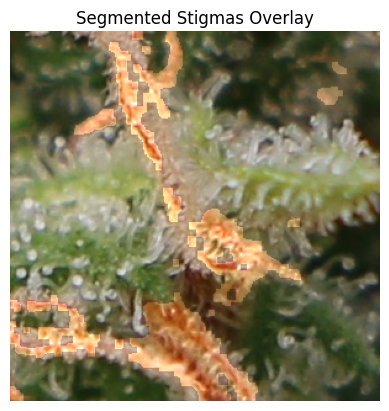

In [ ]:
# Call the function with the path to your image
segment_stigmas(image_path)

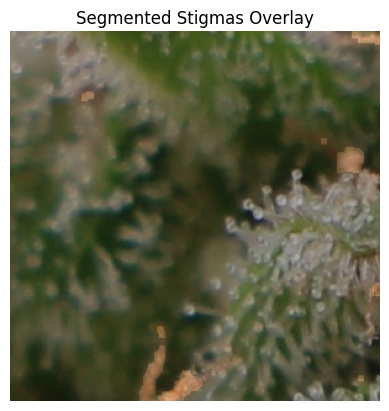

In [ ]:
segment_stigmas("/content/trichome1.jpeg")

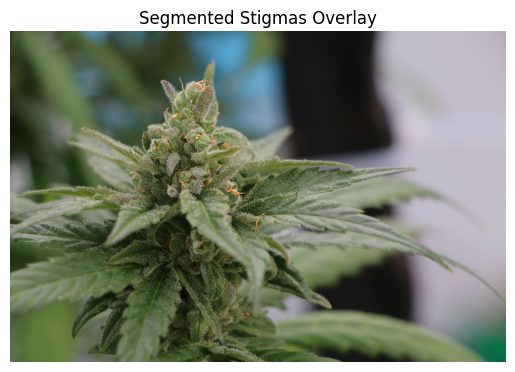

In [ ]:
segment_stigmas("/content/drive/MyDrive/trichomes counting project/trichomes images/trichomes images unprocessed/Camera/IMG_5757.JPG")

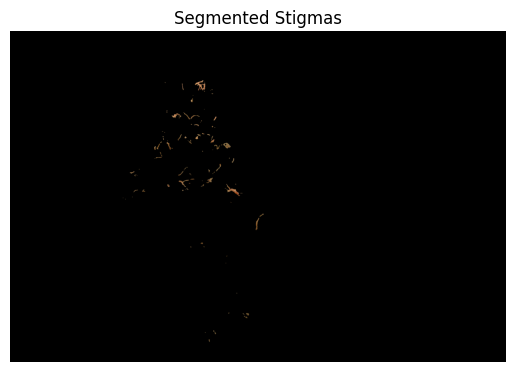

In [ ]:
segment_stigmas_no_background("/content/drive/MyDrive/trichomes counting project/trichomes images/trichomes images unprocessed/Camera/IMG_5757.JPG")

## Testing on multiple Images

In [ ]:
import os
# set the file path
file_path = "/content/drive/MyDrive/trichomes counting project/trichomes images/trichomes image patches/trichomes_patches_Camera/IMG_5759"

# create an empty list to store the images
images_5759 = []

# loop through each file in the directory
for file_name in os.listdir(file_path):
    
    # check if the file is an image file
    if file_name.endswith(".jpg") or file_name.endswith(".png"):
        
        # load the image and append it to the list
        image = cv2.imread(os.path.join(file_path, file_name))
        images_5759.append(image)

# print the number of images loaded
print(f"Loaded {len(images_5759)} images.")

Loaded 12 images.


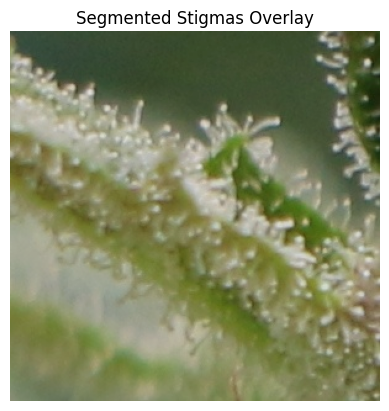

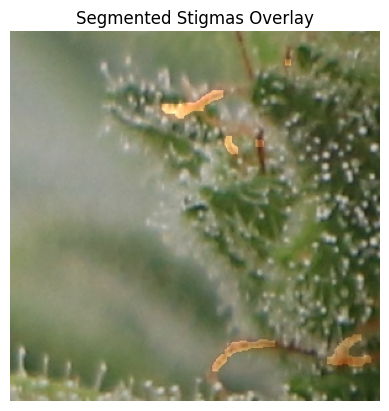

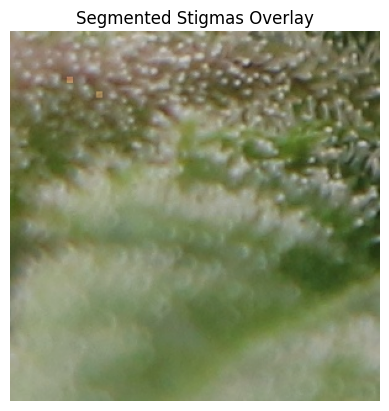

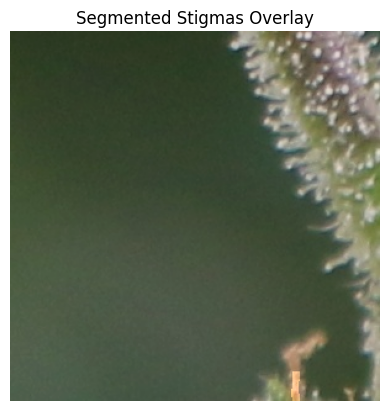

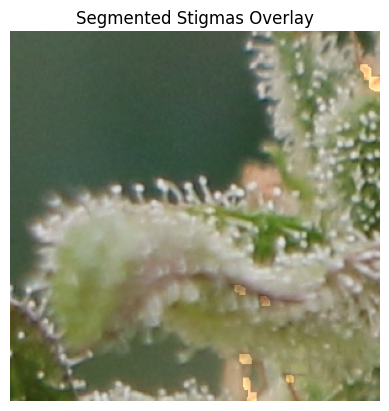

...

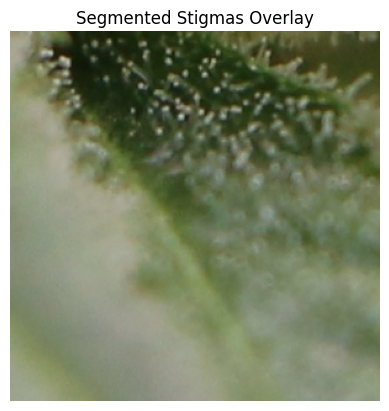

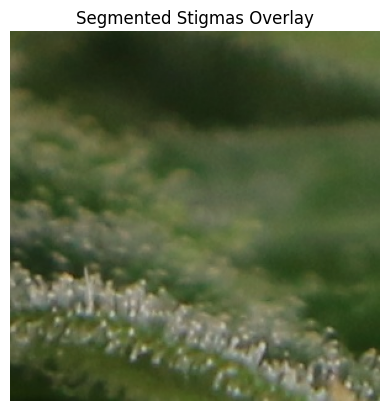

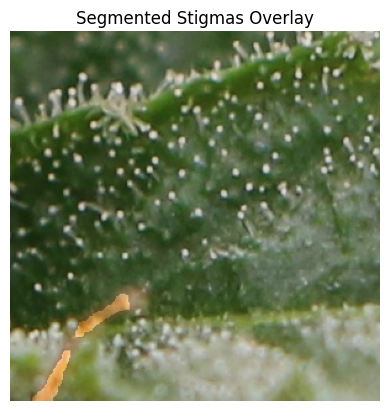

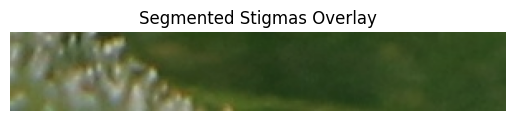

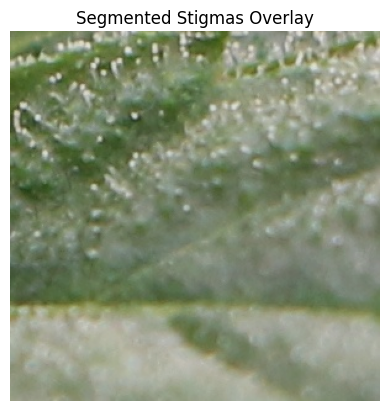

In [ ]:
for image in images_5757:
    segment_stigmas(image)

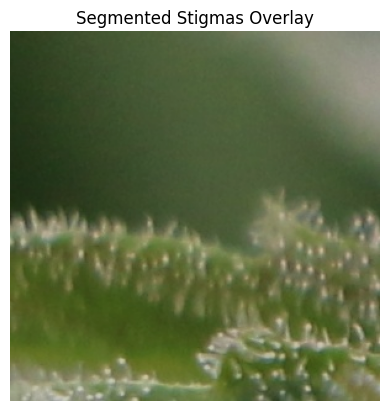

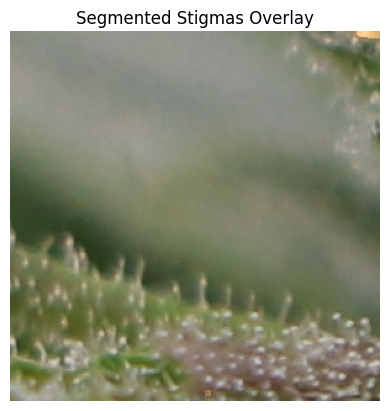

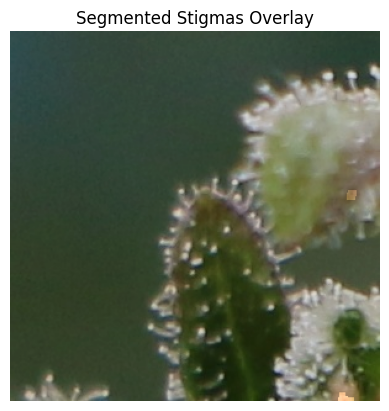

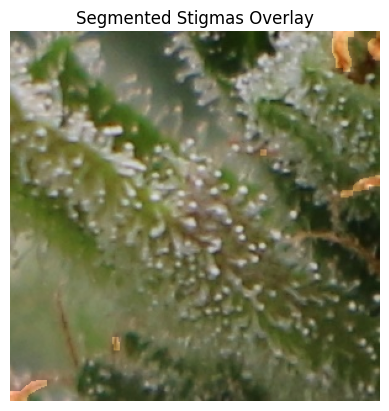

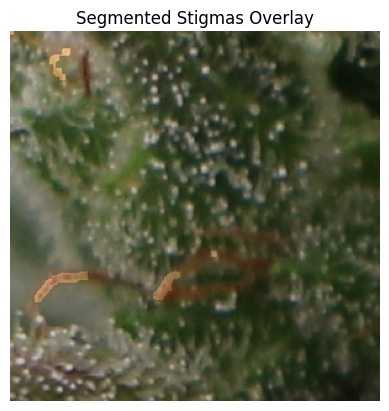

...

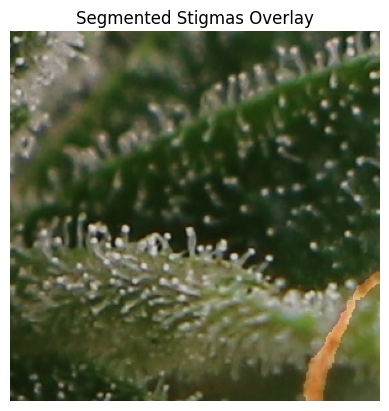

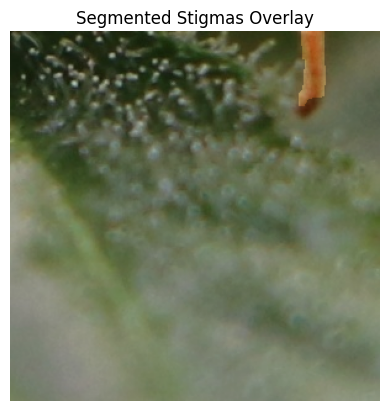

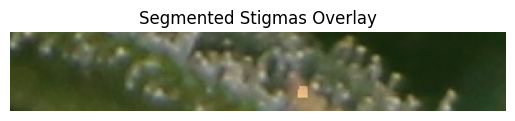

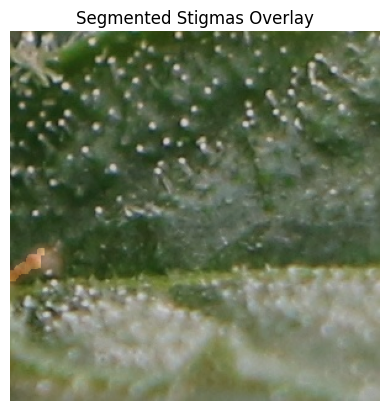

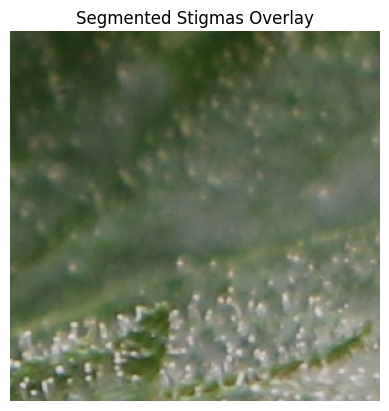

In [ ]:
for image in images_5758:
    segment_stigmas(image)

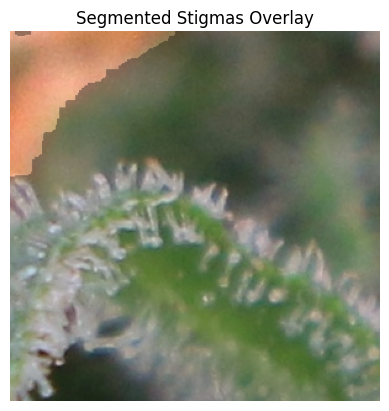

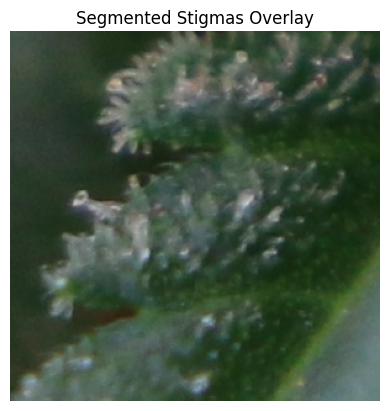

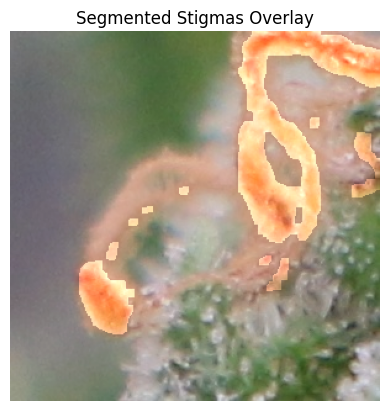

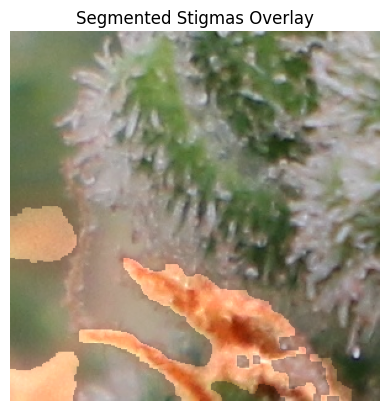

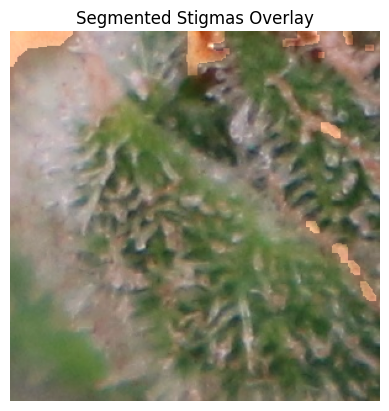

...

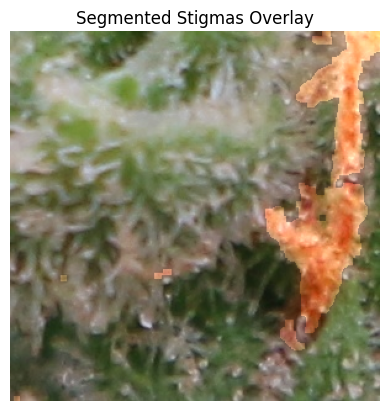

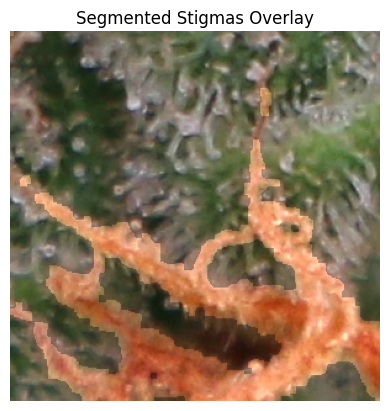

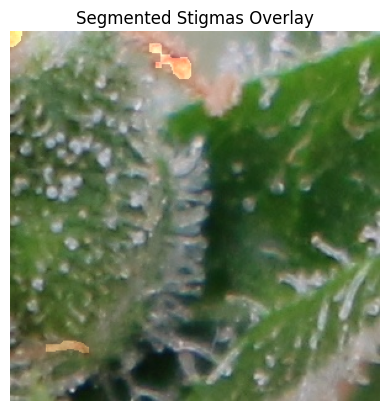

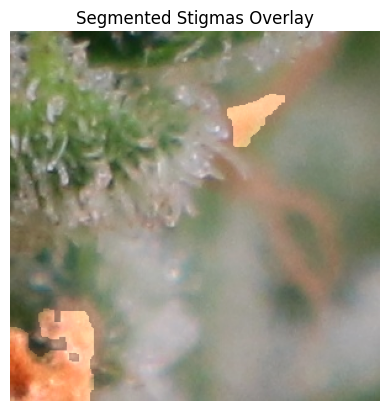

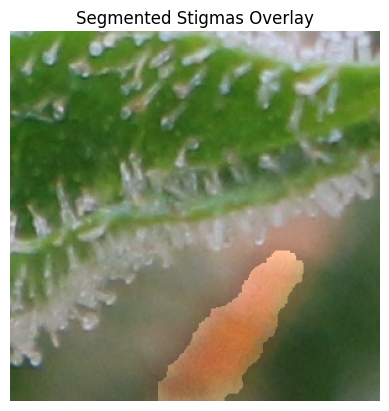

In [ ]:
for image in images_5759:
    segment_stigmas(image)